<a href="https://colab.research.google.com/github/ahmabboud/Zoom-Meeting-Engagement-Recognition/blob/main/Record_Upper_Bodies.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Record Upper Bodies


In [ ]:
!apt-get install python3-OpenCV
!pip install pafy
!pip install youtube_dl

Reading package lists... Done
Building dependency tree       
Reading state information... Done
E: Unable to locate package python3-OpenCV


In [ ]:
import cv2
import matplotlib
import numpy as np
import pafy
from google.colab.patches import cv2_imshow
import time
import uuid

# Python program to show time by process_time()  
from time import process_time

In [ ]:


class staticROI(object):
    def __init__(self,path,SkipFps):
        self.path=path
        
        video = pafy.new(path)
        best = video.getbest()
        self.capture = cv2.VideoCapture() 
        self.capture.open(best.url)
        self.Fps= int(self.capture.get(cv2.CAP_PROP_FPS))
        self.SkipFps=SkipFps
        # Bounding box reference points and boolean if we are extracting coordinates
        self.image_coordinates = []
        self.extract = False
        self.selected_ROI = False
        self.update()

    def update(self):
        i=0
        while True:
            if self.capture.isOpened():
                # Read frame
                (self.status, self.frame) = self.capture.read()
                if i%(self.SkipFps * self.Fps)==0:
                  cv2_imshow(self.frame)
                  key = cv2.waitKey(2)

                # Crop image
                if key == ord('c'):
                    self.clone = self.frame.copy()
                    cv2.namedWindow('image')
                    cv2.setMouseCallback('image', self.extract_coordinates)
                    while True:
                        key = cv2.waitKey(2)
                        cv2_imshow(self.clone)

                        # Crop and display cropped image
                        if key == ord('c'):
                            self.crop_ROI()
                            self.show_cropped_ROI()

                        # Resume video
                        if key == ord('r'):
                            break
                # Close program with keyboard 'q'
                if key == ord('q'):
                    cv2.destroyAllWindows()
                    exit(1)
            else:
                i+=1
                pass

    def extract_coordinates(self, event, x, y, flags, parameters):
        # Record starting (x,y) coordinates on left mouse button click
        if event == cv2.EVENT_LBUTTONDOWN:
            self.image_coordinates = [(x,y)]
            self.extract = True

        # Record ending (x,y) coordintes on left mouse bottom release
        elif event == cv2.EVENT_LBUTTONUP:
            self.image_coordinates.append((x,y))
            self.extract = False

            self.selected_ROI = True

            # Draw rectangle around ROI
            cv2.rectangle(self.clone, self.image_coordinates[0], self.image_coordinates[1], (0,255,0), 2)

        # Clear drawing boxes on right mouse button click
        elif event == cv2.EVENT_RBUTTONDOWN:
            self.clone = self.frame.copy()
            self.selected_ROI = False
        else:
            self.image_coordinates = [(10,10)]
            self.extract = True
            self.image_coordinates.append((20,20))
            self.extract = False
            self.selected_ROI = True

    def crop_ROI(self):
        if self.selected_ROI:
            self.cropped_image = self.frame.copy()

            x1 = self.image_coordinates[0][0]
            y1 = self.image_coordinates[0][1]
            x2 = self.image_coordinates[1][0]
            y2 = self.image_coordinates[1][1]

            self.cropped_image = self.cropped_image[y1:y2, x1:x2]

            print('Cropped image: {} {}'.format(self.image_coordinates[0], self.image_coordinates[1]))
        else:
            print('Select ROI to crop before cropping')

    def show_cropped_ROI(self):
        cv2_imshow(self.cropped_image)


https://www.youtube.com/watch?v=xAXLMoYr2KY
xAXLMoYr2KY


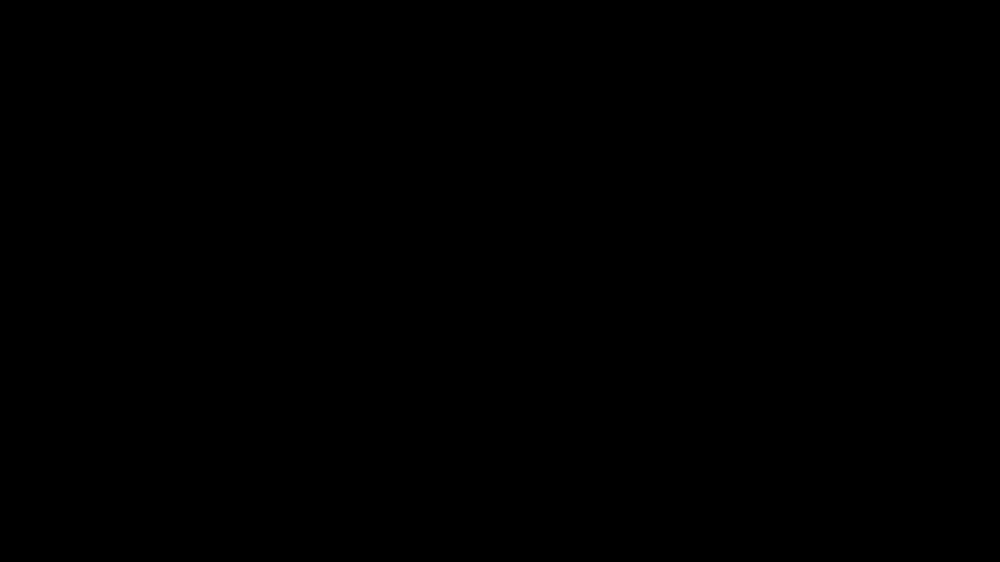

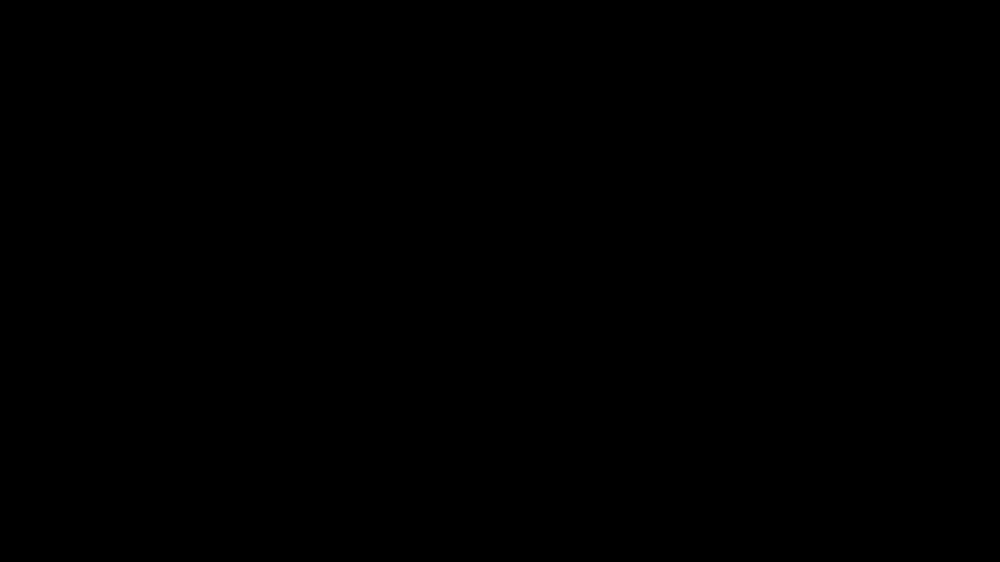

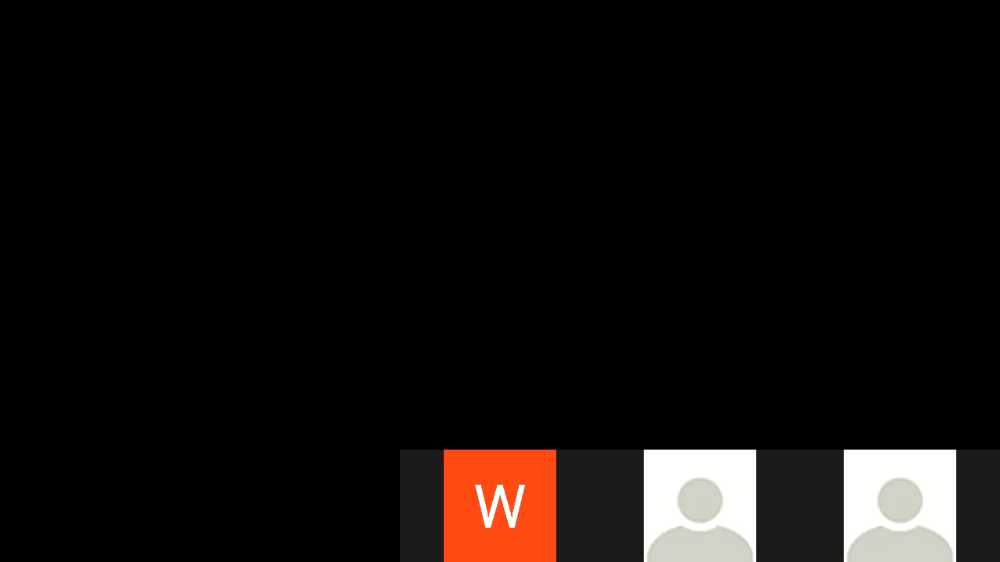

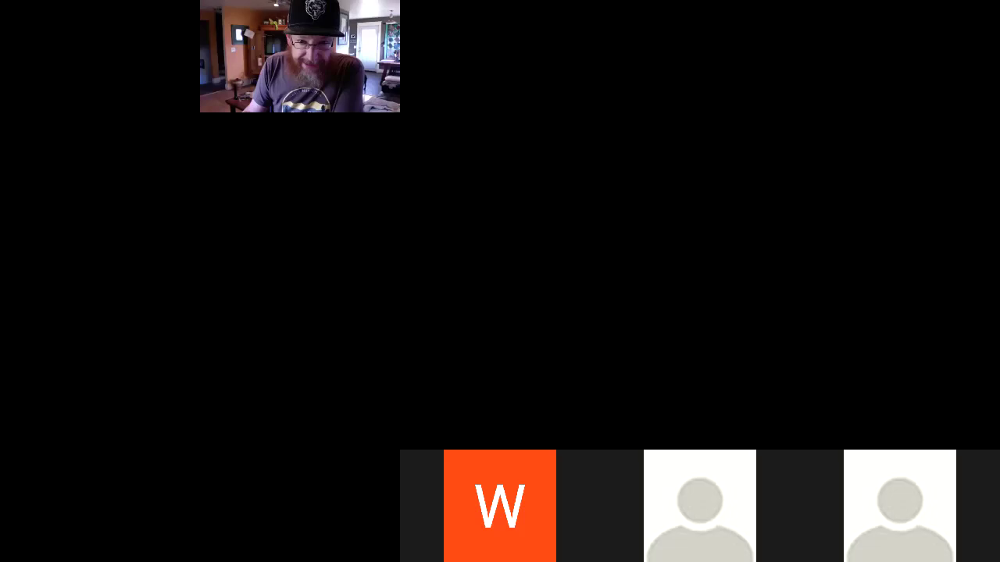

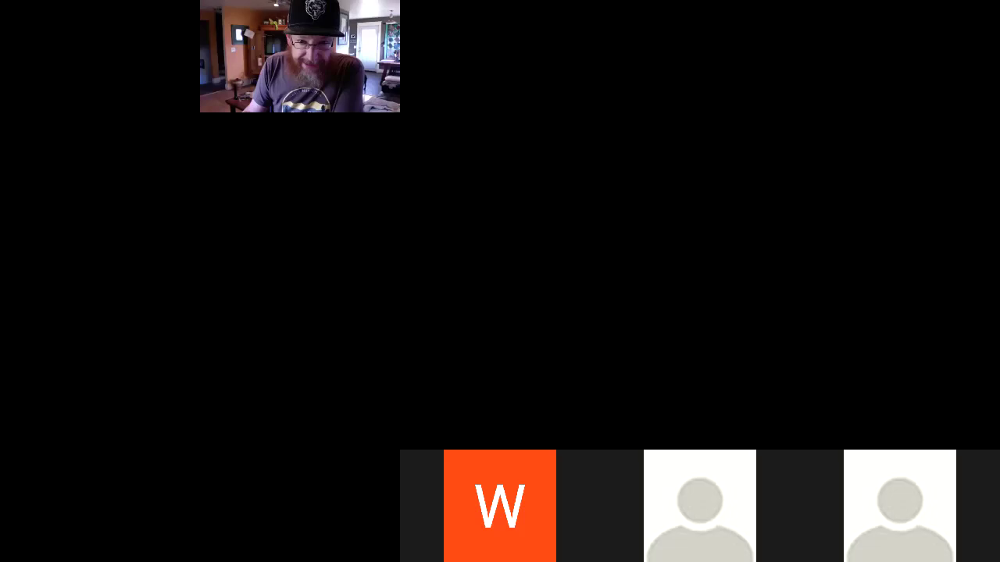

...

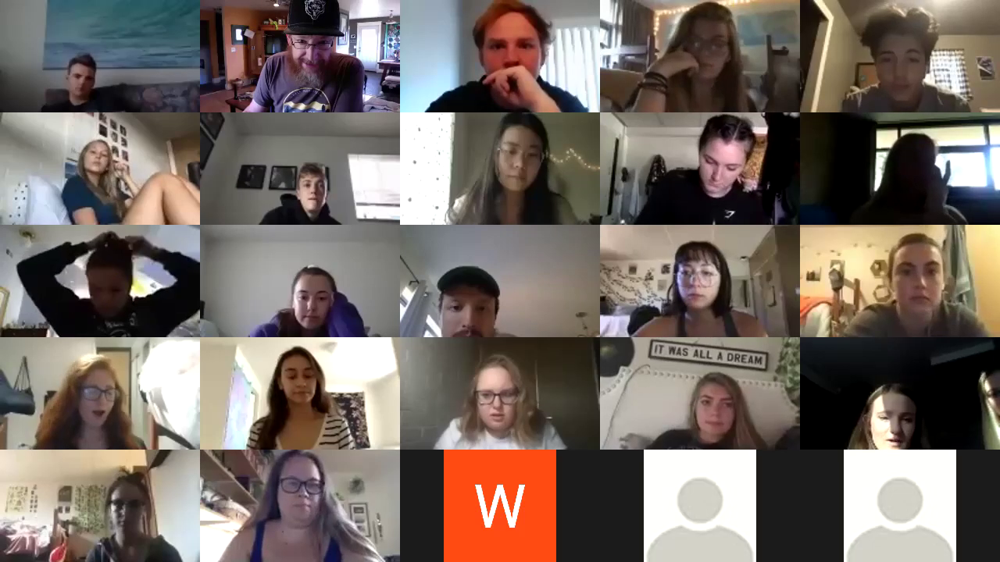

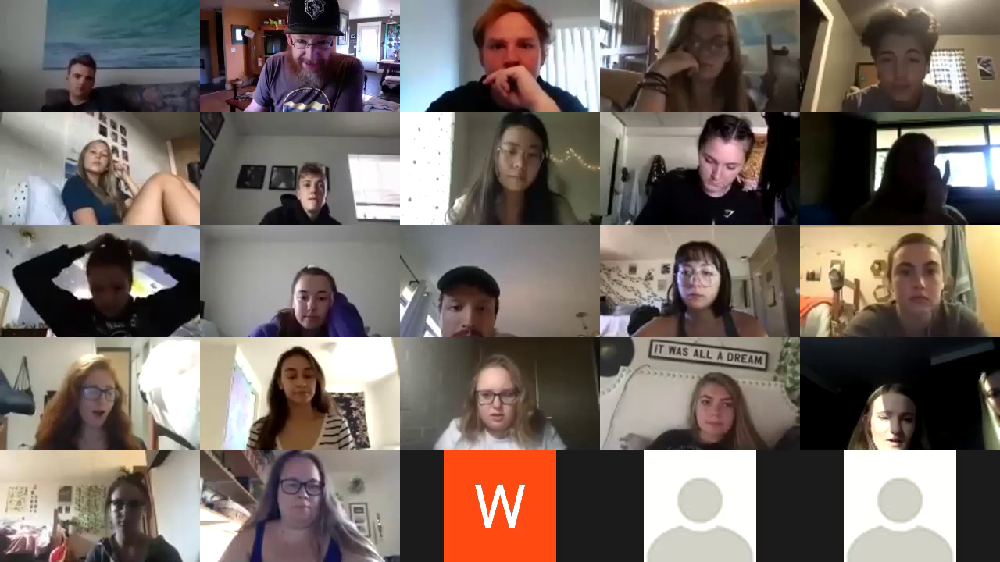

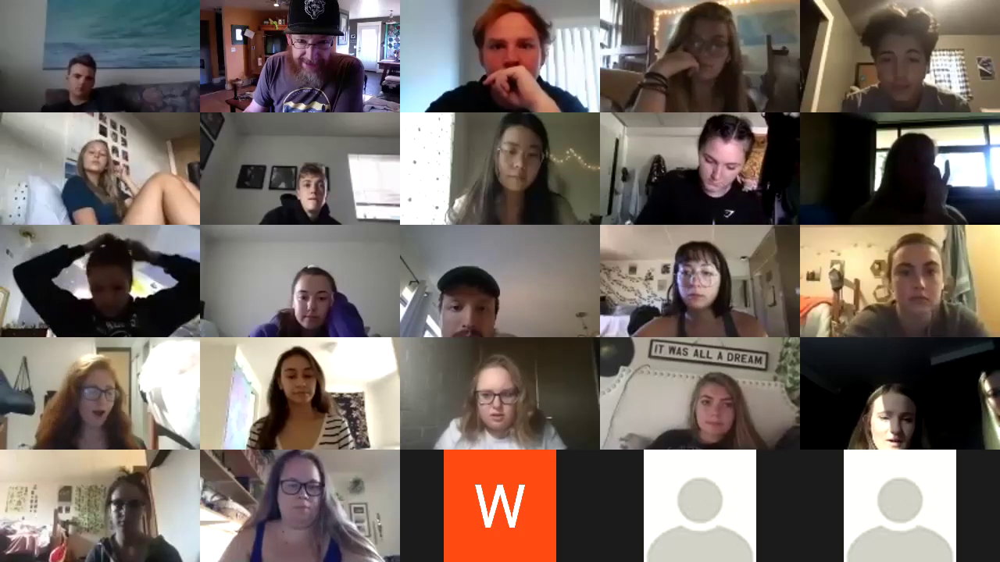

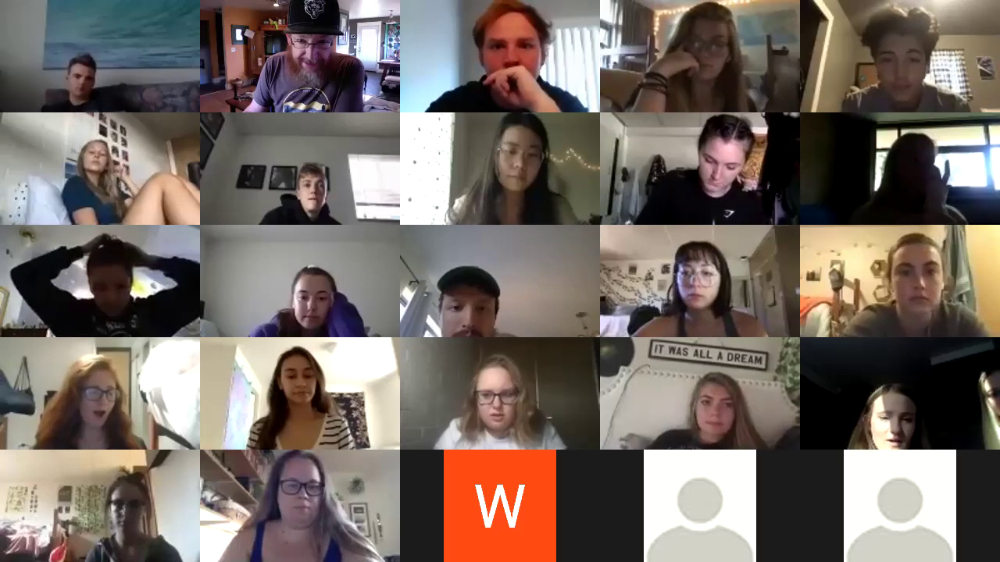

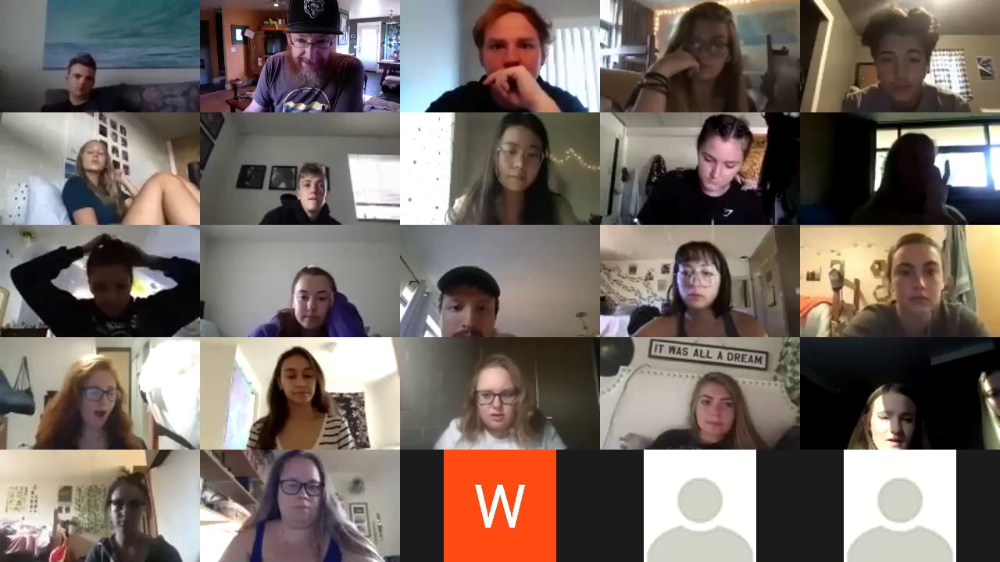

In [ ]:

if __name__ == '__main__':

  # Start the stopwatch / counter  
  t1_start = process_time() 
  file1 = open('/content/drive/My Drive/FellowAI/Dataset_Emo/ZoomLinks3.txt', 'r') 
  Lines = file1.readlines()   
  # Strips the newline character 
  for line in Lines: 
      url=line.strip()
      print(url)
      Uid=url[-11:]
      print(Uid)
      static_ROI = staticROI(url,10)